# Современные методы анализа данных и машинного обучения, БИ

## НИУ ВШЭ, 2023-24 учебный год

# Семинар 17. Градиентный бустинг


Сегодня мы с вами разберем новую модель ансамблей в машинном обучении, — градиентный бустинг, — традиционно являющуюся одним из сильнейших алгоритмов всего классического обучения как такового (если не брать в расчёт нейронные сети и всё, касающееся глубинного обучения) и на многих задачах позволяющую получать максимальное, а нередко и вовсе ни с чем не сравнимое качество результатов с точки зрения метрик и функционала ошибки.

## Постановка задачи

Для того чтобы применить данный ансамблевый алгоритм на практике, будем решать задачу классификации на датасете [Parkinsons](https://archive.ics.uci.edu/ml/datasets/parkinsons). Этот датасет состоит из ряда биомедицинских измерений голоса 31 человека, 23 из которых страдают болезнью Паркинсона. Каждый столбец в таблице представляет собой конкретный показатель голоса человека, а каждая строка соответствует одной из 195 записей голоса пациентов. Необходимо отличить здоровых людей от людей с БП в соответствии со столбцом «статус», в котором установлено значение 0 для здоровых и 1 — для больных паркинсоном.

Мотивацией к решению подобной задачи на реальных данных является тот факт, что, поскольку болезнь Паркинсона — это медленно прогрессирующее и довольно сложно детектируемое заболевание, иногда даже подготовленным людям совсем непросто сразу заметить изменения в поведении человека, что в свою очередь может привести к запусканию развития болезни. Хотелось бы иметь возможность каким-то образом на постоянной основе мониторить состояние человека без необходимости частого посещения врача. В этих целях можно разработать модель, которая будет постоянно отслеживать состояние нашего пациента и при малейших подозрениях на возможное начало развития болезни — сразу же отправлять его к специалисту.

Другой способ применения — обязательное обследование и анализ при помощи модели, чтобы отсеять заведомо здоровых клиентов для уменьшения нагрузки на врача.

## Описание данных

Итак, мы уже выяснили с вами, что наш датасет содержит в себе описания пациентов. Данное описание реализуется засчёт 24 различных признаков, представляющих собой биологические измерения голоса. Вот все признаки датасета:

* 1 — name — id пациент-запись;
* 2 — MDVP:Fo(Hz) — Средняя основная частота вокала;
* 3 — MDVP:Fhi(Hz) — Максимальная основная частота вокала;
* 4 — MDVP:Flo(Hz) — Минимальная основная частота вокала;
* 5-9 — MDVP:Jitter(%), MDVP:Jitter(Abs), MDVP:RAP, MDVP:PPQ, Jitter:DDP — Несколько показателей изменения основной частоты;
* 10-16 — MDVP:Shimmer, MDVP:Shimmer(dB), Shimmer:APQ3, Shimmer:APQ5, MDVP:APQ, Shimmer:DDA — Несколько показателей вариации амплитуды;
* 17-18 — NHR, HNR — Две меры отношения шума к тональным компонентам в голосе;
* 20-21 — RPDE, D2 — Две нелинейные меры динамической сложности;
* 22 — DFA — экспонента масштабирования фрактала сигнала;
* 23-25 — spread1, spread2, PPE — три нелинейные меры изменения основной частоты.

И, конечно, столбец, содержащий целевую переменную:
* 19 — status — Состояние здоровья субъекта: единица — болезнь Паркинсона; ноль — здоров.

In [ ]:
# Импортируем наши стандартные библиотеки
from copy import deepcopy

import numpy as np
import pandas as pd
import seaborn as sns
import matplotlib.pyplot as plt

%matplotlib inline
sns.set()

np.random.seed(2024)

Скачаем данные при помощи команды `gdown` (второй аргумент — это не ссылка на файл!)


In [ ]:
# file_id = 13iZSrbgIzYemEQiRqLWUsOpDeTiEpsU9
! gdown https://drive.google.com/uc?id=13iZSrbgIzYemEQiRqLWUsOpDeTiEpsU9

Downloading...
From: https://drive.google.com/uc?id=13iZSrbgIzYemEQiRqLWUsOpDeTiEpsU9
To: /content/parkinsons.csv
100% 1.79M/1.79M [00:00<00:00, 79.4MB/s]


Cчитаем теперь данные при помощи метода `read_csv` библиотеки `pandas`.


In [ ]:
df = pd.read_csv("parkinsons.csv")

Удалим из названий колонок все странные символы и прочие некорректности. Оставим лишь буквенные названия.

Проверим, что всё считалось, преобразовалось и отображается правильно.

In [ ]:
import re
df = df.rename(columns = lambda x:re.sub('[^A-Za-z0-9_]+', '', x))

In [ ]:
df.sample(7)

,MDVPFoHz,MDVPFhiHz,MDVPFloHz,MDVPJitter,MDVPJitterAbs,MDVPRAP,MDVPPPQ,JitterDDP,MDVPShimmer,MDVPShimmerdB,...,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE,status,name
702,183.799849,197.430524,171.057944,0.002991,0.000017,0.001905,0.002007,0.005732,0.012772,0.123218,...,0.006580,27.286233,0.395796,0.713691,-6.973281,0.135748,2.003240,0.115270,0.0,702
3490,160.228651,205.192831,103.348585,0.000925,0.000002,0.000253,0.001003,0.000753,0.003869,0.033272,...,-0.035718,27.200819,0.358702,0.775468,-6.224239,0.196674,2.307152,0.160715,1.0,3490
2385,94.574409,102.107771,99.744768,0.008229,0.000079,0.004450,0.005246,0.013334,0.043830,0.435366,...,0.019744,19.610440,0.576194,0.801609,-4.454742,0.312897,2.310643,0.310721,1.0,2385
1393,120.235898,120.319322,83.682215,0.012066,0.000098,0.007099,0.005096,0.021290,0.045586,0.414912,...,0.064298,18.279307,0.646451,0.683744,-3.912322,0.288115,2.716119,0.275925,1.0,1393
2030,131.603581,91.819307,131.100335,0.002422,0.000023,0.000875,0.001222,0.002624,0.024114,0.191943,...,-0.003915,22.898897,0.524847,0.711769,-5.512571,0.224391,2.186954,0.214586,1.0,2030
2061,174.074148,257.536432,90.490299,0.004966,0.000020,0.002347,0.002281,0.007043,0.024872,0.228186,...,0.024090,23.683289,0.527549,0.674154,-5.372815,0.331561,2.822897,0.230984,1.0,2061
885,202.859874,163.899699,129.329217,0.004220,0.000023,0.001938,0.002084,0.005826,0.017442,0.160173,...,0.015180,24.600755,0.436154,0.680094,-6.677187,0.152147,2.326978,0.127450,0.0,885


Всё замечательно!

## Подготовка данных

Для начала давайте проверим, есть ли в наших данных пропуски, а заодно посмотрим на типы признаков при помощи метода `info`.


In [ ]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 4000 entries, 0 to 3999
Data columns (total 24 columns):
 #   Column         Non-Null Count  Dtype  
---  ------         --------------  -----  
 0   MDVPFoHz       4000 non-null   float64
 1   MDVPFhiHz      4000 non-null   float64
 2   MDVPFloHz      4000 non-null   float64
 3   MDVPJitter     4000 non-null   float64
 4   MDVPJitterAbs  4000 non-null   float64
 5   MDVPRAP        4000 non-null   float64
 6   MDVPPPQ        4000 non-null   float64
 7   JitterDDP      4000 non-null   float64
 8   MDVPShimmer    4000 non-null   float64
 9   MDVPShimmerdB  4000 non-null   float64
 10  ShimmerAPQ3    4000 non-null   float64
 11  ShimmerAPQ5    4000 non-null   float64
 12  MDVPAPQ        4000 non-null   float64
 13  ShimmerDDA     4000 non-null   float64
 14  NHR            4000 non-null   float64
 15  HNR            4000 non-null   float64
 16  RPDE           4000 non-null   float64
 17  DFA            4000 non-null   float64
 18  spread1 

Уже видно, что у нас в датасете нет пропусков и все данные являются числовыми, что, конечно, значительно упрощает нашу дальнейшую работу с ними.

Перед тем как переходить к обучению модели, посмотрим еще на статистики каждого признака, воспользовавшись методом `describe`.

In [ ]:
df.describe()

,MDVPFoHz,MDVPFhiHz,MDVPFloHz,MDVPJitter,MDVPJitterAbs,MDVPRAP,MDVPPPQ,JitterDDP,MDVPShimmer,MDVPShimmerdB,...,NHR,HNR,RPDE,DFA,spread1,spread2,D2,PPE,status,name
count,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,...,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000,4000.000000
mean,154.066451,196.497430,116.430862,0.006147,0.000043,0.003261,0.003412,0.009784,0.029549,0.280437,...,0.024310,21.882981,0.499643,0.718363,-5.701410,0.226435,2.375166,0.205393,0.701250,1999.500000
std,31.684268,64.826518,33.434512,0.003534,0.000026,0.002154,0.002029,0.006462,0.014124,0.145843,...,0.028795,3.331937,0.076340,0.039846,0.883783,0.063590,0.284840,0.071868,0.457767,1154.844867
min,64.845446,3.810054,29.313386,-0.002290,-0.000013,-0.001959,-0.001997,-0.005887,-0.006255,-0.097950,...,-0.042461,10.734641,0.245591,0.596168,-8.098224,0.033613,1.427841,0.031184,0.000000,0.000000
25%,132.597006,153.271882,93.782711,0.003697,0.000025,0.001788,0.001970,0.005361,0.018477,0.169647,...,0.005831,19.725926,0.446157,0.690808,-6.361474,0.181697,2.177314,0.148182,0.000000,999.750000
50%,149.769369,189.146050,110.711593,0.005540,0.000040,0.002865,0.003031,0.008594,0.027119,0.254111,...,0.019541,22.005644,0.500779,0.717595,-5.652116,0.226965,2.361430,0.206103,1.000000,1999.500000
75%,171.528004,230.131756,132.531355,0.007947,0.000058,0.004341,0.004454,0.013005,0.038345,0.364116,...,0.037823,24.166649,0.554109,0.746250,-5.071574,0.270018,2.567220,0.255103,1.000000,2999.250000
max,311.480923,543.607861,271.022682,0.024855,0.000185,0.015691,0.014328,0.047060,0.091909,0.910901,...,0.209710,32.739197,0.741927,0.835685,-2.852659,0.425241,3.573618,0.464673,1.000000,3999.000000


Особое внимание следует уделить также целевой переменной. Давайте отдельно посмотрим на соотношение классов для таргета.

In [ ]:
print(f"В датасете {len(df)} объектов")
print(f"В данных {sum(df.status == 0)} объектов класса 0")
print(f"В данных {sum(df.status == 1)} объектов класса 1")

В датасете 4000 объектов
В данных 1195 объектов класса 0
В данных 2805 объектов класса 1


Что вы можете сказать про такое соотношение?

Мы видим достаточно необычную ситуацию: в датасете доминирует таргетный класс. Это означает, что нам надо быть очень осторожными при подсчете метрик — ведь распределение классов в жизни будет диаметрально противоположным!

Один из вариантов решения этой проблемы — инвертировать классы: чтобы нулевой класс стал первым, а первый — нулевым. Но в данном случае мы всё же будем просто аккуратны в подсчете метрик: для нас важно, чтобы нулевой класс был почти полностью распознан верно.

Что касается первичной визуализации в рамках EDA, то пока у нас ещё многовато признаков. Давайте вначале построим baseline модель, проведем простой отбор атрибутов и уже после этого попробуем проанализировать данные по графикам.

## Машинное обучение

Для решения нашей задачи и оценки качества в рамках неё будем использовать функцию `classification_report` модуля `metrics` библиотеки `sklearn`. Данная функция очень полезна, поскольку считает все самые популярные и важные метрики для задачи классификации, что позволяет держать всё в одном месте наглядно.

Для ошибок же и их отслеживания в рамках каждого класса — будем использовать уже знакомую нам `confusion_matrix`.

In [ ]:
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay as plot_confusion_matrix

Итак, разделим данные на признаки и таргет, не забыв удалить столбец с id.


In [ ]:
X = df.drop(columns=["status", "name"])
y = df["status"]

Разобьем данные на обучение и тест при помощи хорошо нам знакомой функции `train_test_split`. Также не забудем о стратификации!


In [ ]:
from sklearn.model_selection import train_test_split

X_train, X_test, y_train, y_test = train_test_split(X, y, stratify=y, test_size=0.2, random_state=13)

## Градиентный бустинг

Сегодня нашей моделью машинного обучения будет являться градиентный бустинг. Фактически данная модель представляет собой ансамбль алгоритмов (чаще всего — ансамбль деревьев), который с математической точки зрения действует прямо противоположным образом в сравнении с бэггингом (решающим лесом) — другим, уже знакомым нам ансамблем алгоритмов.

#### Вопрос

Напомните, что представляют собой такие понятия как bias и variance для ошибки алгоритма?

#### Вопрос

Для картинки ниже — соотнесите, в каких случаях bias высокий/низкий, в каких случаях variance высокая/низкая. Какую интерпретацию можно для них предложить?

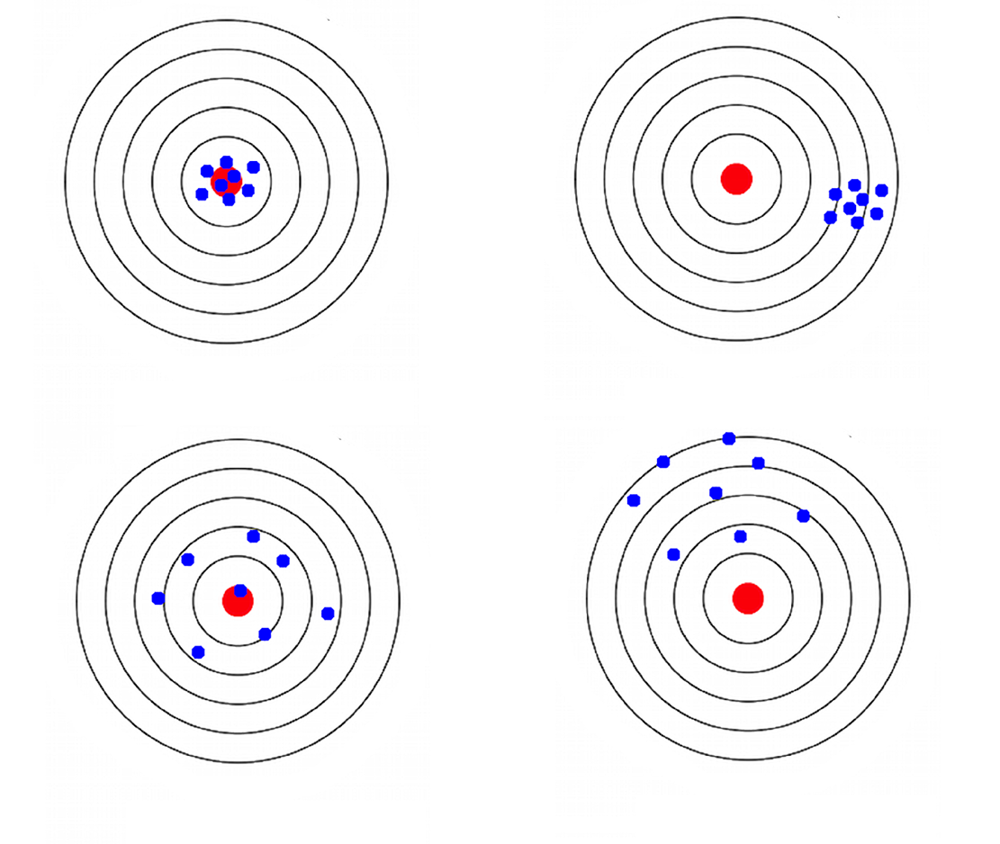

#### Вопрос

В чем заключается основной принцип обоснования эффективности решающего леса, с точки зрения bias/variance?

#### Ответ

Каждый алгоритм (каждое дерево) в ансамбле будем брать глубоко переобученным. Тогда у каждого из них по отдельности будет очень низкий bias и очень высокая variance. Далее, путем агреггирования специальным образом, будем при сохранении на том же уровне этого очень низкого bias пытаться снижать variance. Таким образом, постепенно мы будем приближаться к идеальному алгоритму с низким bias и низкой variance.

Отлично, мы с вами вспомнили основные принципы устройства случайного леса, а также такие важные понятия как bias и variance.

Впрочем, вы можете задаться закономерным вопросом: "А зачем? Мы ведь случайный лес и связанные с ним вещи уже обсуждали в прошлый раз."

Дело в том, что, оказывается, вся эта концепция поразительно (не)похожа на то, как работает градиентный бустинг, собственно и являющийся предметом нашего сегодняшнего обсуждения. Без лишних слов —  посмотрите сами.

Для ансамблевого алгоритма градиентного бустинга справедливо следующее. Каждый алгоритм (каждое дерево) в ансамбле будем брать сильно недообученным (слабым). Тогда у каждого из них по отдельности будет очень высокий bias и очень низкая variance. Далее, путем агреггирования специальным образом, будем при сохранении на том же уровне этой очень низкой variance пытаться снижать bias. Таким образом, постепенно мы будем приближаться к идеальному алгоритму с низким bias и низкой variance.

Ну как — ничего не напоминает? :)

Структуру того, как именно внутри устроен градиентный бустинг, как он работает, а также засчет чего достигается описанная выше оптимизация — вы обсудите с вашим семинаристом!

### Построение бейзлайна

В настоящее время существует огромное количество различных имплементаций модели градиентного бустинга на практике, в основном созданные известными IT-гигантами. Все эти имплементации отличаются друг от друга в основном лишь некоторыми нюансами технической реализации и интерпретации результатов.

Ниже на графике вы можете увидеть, как продвигалась индустрия в данной области (где даже смогла, внезапно, отметиться компания из России — не только локально на российском уровне, но и в глобальной гонке).

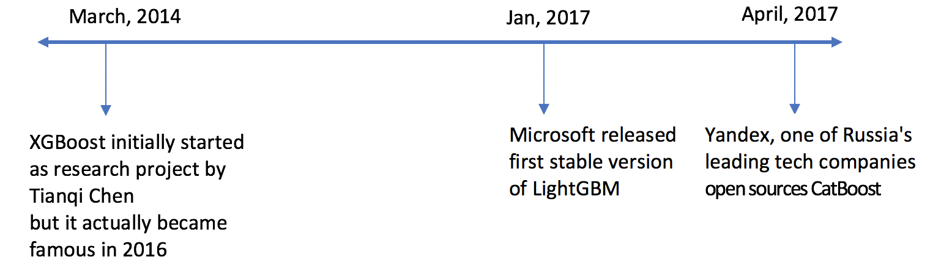

Мы с вами сегодня воспользуемся двумя техническими реализациями градиентного бустинга: обучим их, разберемся в имеющихся возможностях, сравним перформанс друг относительно друга, да и в принципе потренируемся в использовании и интерпретации данного алгоритма. Этими двумя реализациями будет Яндексовский CatBoost и Майкрософтский LGBM.

Важно отметить, что бустинг — это в принципе очень мощная модель. Обычно в качестве бейзлайнов используют модели всё же попроще. Тем не менее, сегодня, поскольку мы хотим попрактиковаться в использовании конкретно бустингов, — будем применять их также и в качестве бейзлайнов — просто все гиперпараметры возьмём у них по умолчанию.

Итак, начнем с того, что установим `catboost`.

In [ ]:
!pip install catboost

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 98.2/98.2 MB 8.6 MB/s eta 0:00:00


Импортируем `CatBoost` и `LightGBM`


In [ ]:
import catboost as cb
import lightgbm as lgb

Создадим экземпляры бустингов-классификаторов (`CatBoostClassifier` и `LGBMClassifier`) и обучим их на обучающей части датасета. Укажем `verbose=0`, чтобы модели с нами не разговаривали во время обучения :)

In [ ]:
CB_model = cb.CatBoostClassifier(verbose=0)
LGB_model = lgb.LGBMClassifier(verbose=0)

CB_model.fit(X_train, y_train)
LGB_model.fit(X_train, y_train)

LGBMClassifier(verbose=0)

Посмотрим, как с работой справился LGBM.

TEST
              precision    recall  f1-score   support

         0.0       0.81      0.72      0.77       239
         1.0       0.89      0.93      0.91       561

    accuracy                           0.87       800
   macro avg       0.85      0.83      0.84       800
weighted avg       0.87      0.87      0.87       800

TRAIN
              precision    recall  f1-score   support

         0.0       1.00      0.97      0.98       956
         1.0       0.99      1.00      0.99      2244

    accuracy                           0.99      3200
   macro avg       0.99      0.98      0.99      3200
weighted avg       0.99      0.99      0.99      3200



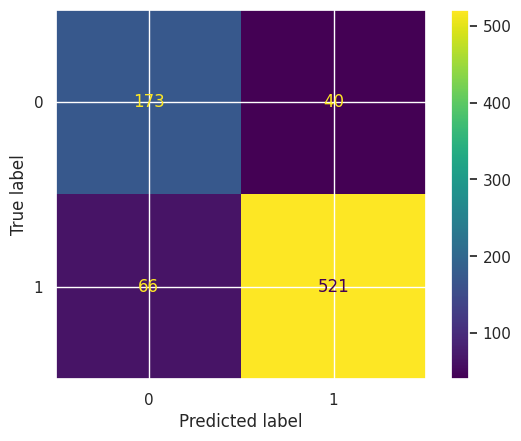

In [ ]:
# Получить отчет классификации передав в classification_report реальные метки и предсказанные
print("TEST")
print(classification_report(y_test, LGB_model.predict(X_test)))
print("TRAIN")
print(classification_report(y_train, LGB_model.predict(X_train)))

# Посмотреть на матрицу ошибок, передав в plot_confusion_matrix модель, тестовые данные и тестовые метки
cm = confusion_matrix(LGB_model.predict(X_test), y_test)
disp = plot_confusion_matrix(cm)
disp.plot()
plt.show()

Посмотрим, как с работой справился CatBoost


TEST
              precision    recall  f1-score   support

         0.0       0.84      0.71      0.77       239
         1.0       0.88      0.94      0.91       561

    accuracy                           0.87       800
   macro avg       0.86      0.83      0.84       800
weighted avg       0.87      0.87      0.87       800

TRAIN
              precision    recall  f1-score   support

         0.0       0.95      0.83      0.89       956
         1.0       0.93      0.98      0.96      2244

    accuracy                           0.94      3200
   macro avg       0.94      0.91      0.92      3200
weighted avg       0.94      0.94      0.94      3200



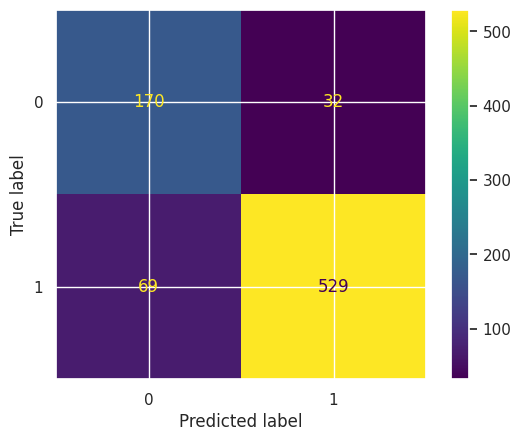

In [ ]:
# Получить отчет классификации передав в classification_report реальные метки и предсказанные
print("TEST")
print(classification_report(y_test, CB_model.predict(X_test)))
print("TRAIN")
print(classification_report(y_train, CB_model.predict(X_train)))

# Посмотреть на матрицу ошибок, передав в plot_confusion_matrix модель, тестовые данные и тестовые метки
cm = confusion_matrix(CB_model.predict(X_test), y_test)
disp = plot_confusion_matrix(cm)
disp.plot()
plt.show()

Видим, что оба алгоритма отлично справляются, но, судя по метрикам на обучении, бустинги недообучились из-за того, что данных мало!

Посмотрим, какие признаки какой бустинг выбрал важными при помощи метода `feature_importances`.

Чтобы понять, какому признаку какой вес соответствует, мы соединим названия признаков и `feature_importances` при помощи функции `zip`. Кроме того, отсортируем их по важности

In [ ]:
print(f"Важность признаков в LGBM: {sorted(zip(X_train.columns, LGB_model.feature_importances_), key=lambda x: -x[1])}")
print(f"Важность признаков в CatB: {sorted(zip(X_train.columns, CB_model.feature_importances_), key=lambda x: -x[1])}")

Важность признаков в LGBM: [('MDVPFloHz', 218), ('HNR', 214), ('spread2', 209), ('MDVPAPQ', 194), ('spread1', 193), ('RPDE', 180), ('NHR', 161), ('DFA', 160), ('PPE', 155), ('MDVPFhiHz', 147), ('MDVPFoHz', 141), ('MDVPPPQ', 138), ('D2', 127), ('MDVPJitterAbs', 122), ('MDVPRAP', 111), ('ShimmerAPQ3', 106), ('MDVPShimmer', 104), ('ShimmerAPQ5', 104), ('MDVPJitter', 84), ('MDVPShimmerdB', 75), ('JitterDDP', 38), ('ShimmerDDA', 19)]
Важность признаков в CatB: [('spread1', 9.549684957500666), ('MDVPFloHz', 8.161351479272943), ('spread2', 7.225157902670086), ('MDVPAPQ', 7.15795519149575), ('PPE', 6.853579102170101), ('NHR', 5.988414108050262), ('DFA', 4.920428726904642), ('MDVPFoHz', 4.830613552346698), ('RPDE', 4.732779400780111), ('MDVPPPQ', 4.611114026554469), ('HNR', 4.575815063314581), ('MDVPFhiHz', 4.084576888698187), ('MDVPJitterAbs', 3.6459979272767518), ('D2', 3.546519246381408), ('ShimmerAPQ5', 3.1047083617654097), ('MDVPRAP', 2.8061874278896046), ('MDVPShimmer', 2.601164381708798)

Выберем все признаки, которые для LGBM имели важность больше 1 и для CatBoost важность больше 2. Так отбирать признаки стоит, только если хотите отсеять совсем шумовые — лучше с этим не увлекаться.


In [ ]:
LGBM_cols = X_train.columns[LGB_model.feature_importances_ > 1]
CB_cols = X_train.columns[CB_model.feature_importances_ > 2]

selected_features = list(set(LGBM_cols) & set(CB_cols))
print(selected_features)

['HNR', 'spread2', 'ShimmerAPQ3', 'PPE', 'MDVPFoHz', 'MDVPAPQ', 'ShimmerDDA', 'ShimmerAPQ5', 'RPDE', 'MDVPJitter', 'MDVPShimmerdB', 'MDVPJitterAbs', 'MDVPPPQ', 'MDVPRAP', 'DFA', 'MDVPShimmer', 'MDVPFhiHz', 'JitterDDP', 'MDVPFloHz', 'spread1', 'NHR', 'D2']


Выберем только эти признаки у обучающего и тестового датасетов.

In [ ]:
X_test = X_test[selected_features]
X_train = X_train[selected_features]

#### Вопрос

Кстати, а что в принципе подразумевается под "важностью признаков"? Как посчитать эту важность для разных алгоритмов, которые мы обсуждали?

### Подбор гиперпараметров

Для нахождения оптимальных гиперпараметров, мы воспользуемся знакомой нам `RandomizedSearchCV`, поскольку, как вы уже, наверное, заметили, даже на маленьком датасете бустинги считаются достаточно долго. (Кстати, как вы думаете почему они значительно медленнее даже тех же самых случайных лесов, где количество деревьев внутри ансамбля сравнимое?)

У бустингов есть два основных параметра, с которых стоит начинать настройку: `learning_rate`/`lr` и `max_depth`. Параметр `n_estimators` (число деревьев) также стараются зафиксировать на достаточном уровне — поскольку у нас мало данных, этот параметр мы оставим без изменения.

Импортируем `GridSearchCV` из модуля `model_selection` библиотеки `sklearn`.


In [ ]:
from sklearn.model_selection import RandomizedSearchCV

Воспользуемся функцией `RandomizedSearchCV` для нашей задачи. В качестве метрики определения "лучшей" модели выберем `f1_score`.

In [ ]:
%%time

grid_LGBM = RandomizedSearchCV(
            lgb.LGBMClassifier(verbose=0),          # Алгоритм, в котором будем подбирать параметры
            param_distributions = {                 # Сетка параметров в виде словаря
                'max_depth': range(2, 7),
                'lr': np.linspace(0.001, 0.3, 100),
            },
            scoring = 'f1',
            cv = 3,                                 # CV для кросс-валидации (число фолдов или индексы)
            n_jobs = -1,                            # Число используемых ядер для работы
            return_train_score = True,              # Считать ли метрики на обучающей части
            n_iter=30,                              # Число итераций (сколько будем брать случайных наборов)
            verbose = 5,                            # Чем больше, тем алгоритм разговорчивее
        )

# Обучим сетку на обучающем датасете при помощи метода fit
grid_LGBM.fit(X_train, y_train)

Fitting 3 folds for each of 30 candidates, totalling 90 fits
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain: -inf
[LightGBM] [Warning] No further splits with positive gain, best gain

RandomizedSearchCV(cv=3, estimator=LGBMClassifier(verbose=0), n_iter=30,
                   n_jobs=-1,
                   param_distributions={'lr': array([0.001     , 0.0040202 , 0.0070404 , 0.01006061, 0.01308081,
       0.01610101, 0.01912121, 0.02214141, 0.02516162, 0.02818182,
       0.03120202, 0.03422222, 0.03724242, 0.04026263, 0.04328283,
       0.04630303, 0.04932323, 0.05234343, 0.05536364, 0.05838384,
       0.06140404, 0.06442424, 0....
       0.21241414, 0.21543434, 0.21845455, 0.22147475, 0.22449495,
       0.22751515, 0.23053535, 0.23355556, 0.23657576, 0.23959596,
       0.24261616, 0.24563636, 0.24865657, 0.25167677, 0.25469697,
       0.25771717, 0.26073737, 0.26375758, 0.26677778, 0.26979798,
       0.27281818, 0.27583838, 0.27885859, 0.28187879, 0.28489899,
       0.28791919, 0.29093939, 0.2939596 , 0.2969798 , 0.3       ]),
                                        'max_depth': range(2, 7)},
                   return_train_score=True, scoring='f1', verbose=5)

In [ ]:
# Выведем набор лучших параметров (они хранятся в best_params_) и лучшую метрику

print(f"Лучшая метрика:   {grid_LGBM.best_score_}")
print(f"Лучшие параметры: {grid_LGBM.best_params_}")

Лучшая метрика:   0.9236427282397958
Лучшие параметры: {'max_depth': 6, 'lr': 0.29093939393939394}


Посмотрим, как с работой теперь справится LGBM

TEST
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
              precision    recall  f1-score   support

         0.0       0.83      0.71      0.76       239
         1.0       0.88      0.94      0.91       561

    accuracy                           0.87       800
   macro avg       0.85      0.82      0.84       800
weighted avg       0.87      0.87      0.87       800

TRAIN
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
              precision    recall  f1-score   support

         0.0       0.98      0.86      0.91       956
         1.0       0.94      0.99      0.97      2244

    accuracy                           0.95      3200
   macro avg       0.96      0.92      0.94      3200
weighted avg       0.95      0.95      0.95 

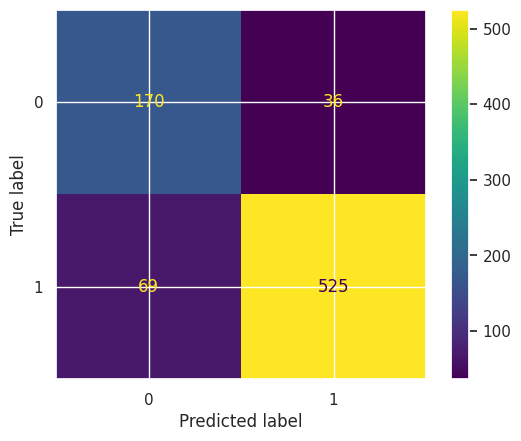

In [ ]:
# Получить отчет классификации передав в classification_report реальные метки и предсказанные
print("TEST")
print(classification_report(y_test, grid_LGBM.best_estimator_.predict(X_test)))
print("TRAIN")
print(classification_report(y_train, grid_LGBM.best_estimator_.predict(X_train)))

# Посмотреть на матрицу ошибок, передав в plot_confusion_matrix модель, тестовые данные и тестовые метки
cm = confusion_matrix(grid_LGBM.best_estimator_.predict(X_test), y_test)
disp = plot_confusion_matrix(cm)
disp.plot()
plt.show()

Воспользуемся функцией `RandomizedSearchCV` для нашей задачи. В качестве метрики определения "лучшей" модели выберем `f1_score`.

In [ ]:
%%time

grid_CB = RandomizedSearchCV(
            cb.CatBoostClassifier(verbose=0),       # Алгоритм, в котором будем подбирать параметры
            param_distributions = {                 # Сетка параметров в виде словаря
                'max_depth': range(2, 7),
                'learning_rate': np.linspace(0.001, 0.3, 100),
            },
            scoring = 'f1',
            cv = 3,                                 # CV для кросс-валидации (число фолдов или индексы)
            n_jobs = -1,                            # Число используемых ядер для работы
            return_train_score = True,              # Считать ли метрики на обучающей части
            n_iter=30,                              # Число итераций (сколько будем брать случайных наборов)
            verbose = 5,                            # Чем больше, тем алгоритм разговорчивее
        )

# Обучим сетку на обучающем датасете при помощи метода fit
grid_CB.fit(X_train, y_train)

Fitting 3 folds for each of 30 candidates, totalling 90 fits
CPU times: user 18.5 s, sys: 1.64 s, total: 20.1 s
Wall time: 8min 48s


RandomizedSearchCV(cv=3,
                   estimator=<catboost.core.CatBoostClassifier object at 0x7bb6ec415630>,
                   n_iter=30, n_jobs=-1,
                   param_distributions={'learning_rate': array([0.001     , 0.0040202 , 0.0070404 , 0.01006061, 0.01308081,
       0.01610101, 0.01912121, 0.02214141, 0.02516162, 0.02818182,
       0.03120202, 0.03422222, 0.03724242, 0.04026263, 0.04328283,
       0.04630303, 0.04932323, 0.05234343, 0.05...
       0.21241414, 0.21543434, 0.21845455, 0.22147475, 0.22449495,
       0.22751515, 0.23053535, 0.23355556, 0.23657576, 0.23959596,
       0.24261616, 0.24563636, 0.24865657, 0.25167677, 0.25469697,
       0.25771717, 0.26073737, 0.26375758, 0.26677778, 0.26979798,
       0.27281818, 0.27583838, 0.27885859, 0.28187879, 0.28489899,
       0.28791919, 0.29093939, 0.2939596 , 0.2969798 , 0.3       ]),
                                        'max_depth': range(2, 7)},
                   return_train_score=True, scoring='f1', verbose=5)

Видно, что `CatBoost` работает в разы медленнее, однако он сходится быстрее, чем `LGBM` и потому суммарное время работы для нахождения оптимума у них примерно одинаковое

In [ ]:
# Выведем набор лучших параметров (они хранятся в best_params_) и лучшую метрику

print(f"Лучшая метрика:   {grid_CB.best_score_}")
print(f"Лучшие параметры: {grid_CB.best_params_}")

Лучшая метрика:   0.9273285933442449
Лучшие параметры: {'max_depth': 6, 'learning_rate': 0.2093939393939394}


Метрика получилась выше!

Посмотрим, как с работой теперь справится CB

TEST
              precision    recall  f1-score   support

         0.0       0.83      0.72      0.77       239
         1.0       0.89      0.94      0.91       561

    accuracy                           0.87       800
   macro avg       0.86      0.83      0.84       800
weighted avg       0.87      0.87      0.87       800

TRAIN
              precision    recall  f1-score   support

         0.0       1.00      1.00      1.00       956
         1.0       1.00      1.00      1.00      2244

    accuracy                           1.00      3200
   macro avg       1.00      1.00      1.00      3200
weighted avg       1.00      1.00      1.00      3200



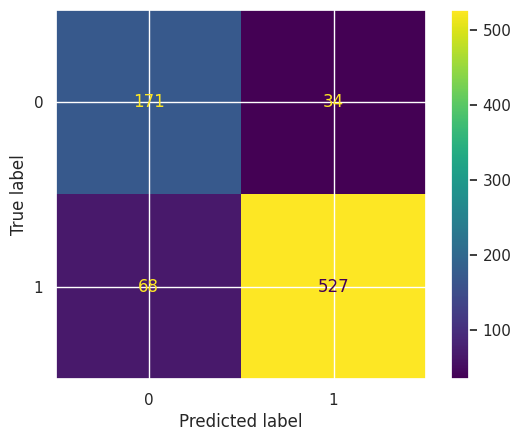

In [ ]:
# Получить отчет классификации передав в classification_report реальные метки и предсказанные
print("TEST")
print(classification_report(y_test, grid_CB.best_estimator_.predict(X_test)))
print("TRAIN")
print(classification_report(y_train, grid_CB.best_estimator_.predict(X_train)))

# Посмотреть на матрицу ошибок, передав в plot_confusion_matrix модель, тестовые данные и тестовые метки
cm = confusion_matrix(grid_CB.best_estimator_.predict(X_test), y_test)
disp = plot_confusion_matrix(cm)
disp.plot()
plt.show()

Видим, что подбор параметров не дал существенного прироста в качестве. Но ничего, такое тоже бывает, тогда давайте построим графики и составим отчет.

### Визуализация

Чтобы не тратить время на отрисовку бесполезных графиков, давайте попробуем отобрать еще признаки при помощи `permutation importance`. Импортируем эту функцию из модуля `inspection` библиотеки `sklearn`.

In [ ]:
from sklearn.inspection import permutation_importance

In [ ]:
%%time
# Воспользуемся поиском важности перемешиванием, для лучшей модели LGBM

result_LGBM = permutation_importance(grid_LGBM.best_estimator_, X_test, y_test,
                                     n_repeats=30,
                                     random_state=0)

# Воспользуемся поиском важности перемешиванием, для лучшей модели CatBoost

result_CB = permutation_importance(grid_CB.best_estimator_, X_test, y_test,
                                     n_repeats=30,
                                     random_state=0)

[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max_depth > num_leaves. (num_leaves=31).
[LightGBM] [Warning] Unknown parameter: lr
[LightGBM] [Warning] Accuracy may be bad since you didn't explicitly set num_leaves OR 2^max

In [ ]:
# Посмотрим, что возвращает эта функция

result_LGBM

{'importances_mean': array([ 0.01254167,  0.01116667, -0.00016667,  0.00375   ,  0.00183333,
         0.02795833,  0.00129167,  0.00320833,  0.00716667,  0.00308333,
         0.005875  ,  0.00270833,  0.00745833,  0.00079167,  0.002125  ,
         0.005625  ,  0.00279167,  0.00375   ,  0.00929167,  0.09866667,
         0.00895833,  0.00375   ]),
 'importances_std': array([0.00255121, 0.00409437, 0.00143372, 0.00302765, 0.00269516,
        0.00649105, 0.00207874, 0.00192796, 0.00213925, 0.00200866,
        0.00219255, 0.0029945 , 0.00362979, 0.0026709 , 0.0024399 ,
        0.00322345, 0.00303938, 0.00311247, 0.00334918, 0.0087615 ,
        0.00470021, 0.00204124]),
 'importances': array([[ 0.01375,  0.0175 ,  0.01125,  0.01125,  0.01125,  0.01375,
          0.0125 ,  0.015  ,  0.00625,  0.01625,  0.01125,  0.01125,
          0.01875,  0.01375,  0.00875,  0.01125,  0.01125,  0.00875,
          0.01125,  0.0125 ,  0.0125 ,  0.01375,  0.01625,  0.01   ,
          0.01125,  0.0125 ,  0.0125

In [ ]:
# Оставим только те признаки, которые дают положительный вклад (то есть importances_mean > 0) хотя бы для одной модели

X_test.columns[(result_LGBM['importances_mean'] > 0) | (result_CB['importances_mean'] > 0)]

Index(['HNR', 'spread2', 'PPE', 'MDVPFoHz', 'MDVPAPQ', 'ShimmerDDA',
       'ShimmerAPQ5', 'RPDE', 'MDVPJitter', 'MDVPShimmerdB', 'MDVPJitterAbs',
       'MDVPPPQ', 'MDVPRAP', 'DFA', 'MDVPShimmer', 'MDVPFhiHz', 'JitterDDP',
       'MDVPFloHz', 'spread1', 'NHR', 'D2'],
      dtype='object')

In [ ]:
# Сохраним лучшие признаки

best_feat = X_test.columns[(result_LGBM['importances_mean'] > 0) | (result_CB['importances_mean'] > 0)]

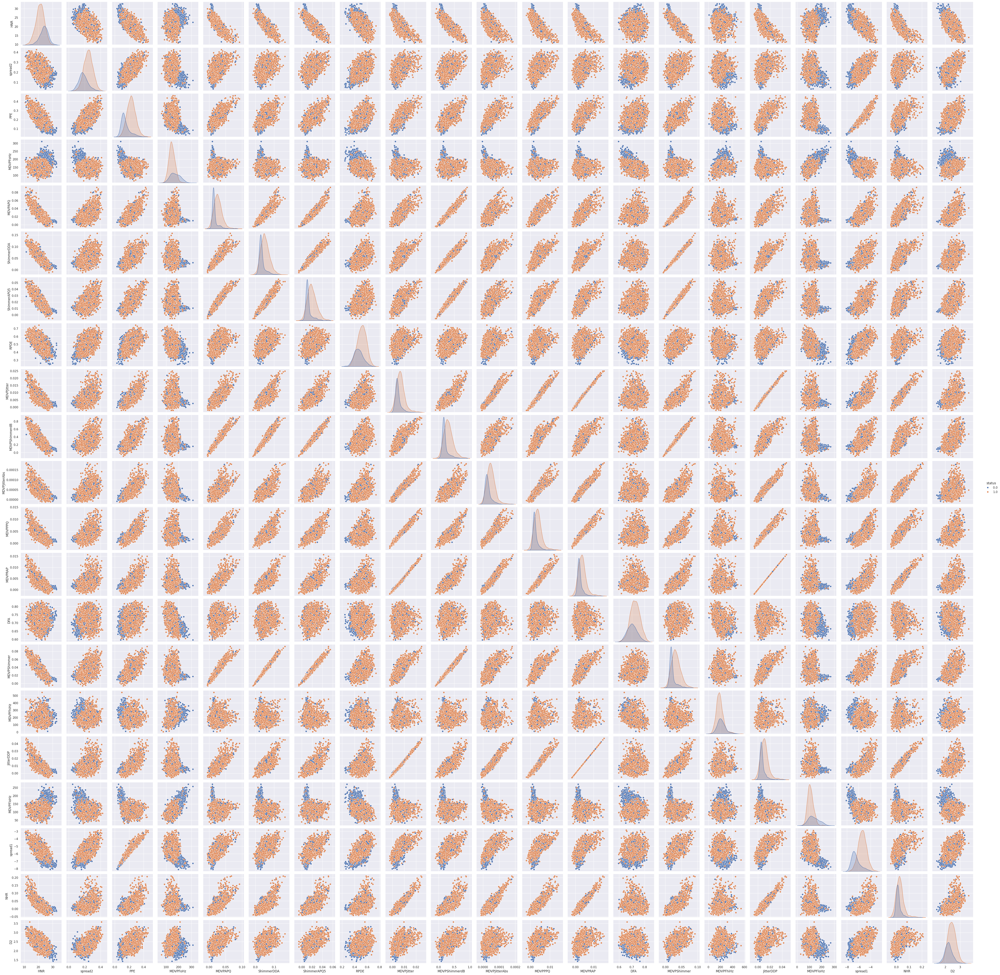

In [ ]:
# Нарисуем pairplot для оставшихся графиков
# Для этого сделаем датасет для отрисовки из изначального

df_plot = df[list(best_feat) + ["status"]]

sns.pairplot(df_plot, hue="status")

Какие выводы можно сделать из этих графиков?

In [ ]:
# Воспользуемся PCA для того, чтобы отрисовать точки в 2d

# Импортируем PCA
from sklearn.decomposition import PCA

# Создаем объект класса PCA с числом главных компонент, равным 2
pca = PCA(n_components=2)

# Преобразуем данные из df_plot в двухмерные при помощи методв fit_transform
# Не забудьте удалить status
df_2d = pca.fit_transform(df_plot.drop(columns=["status"]))

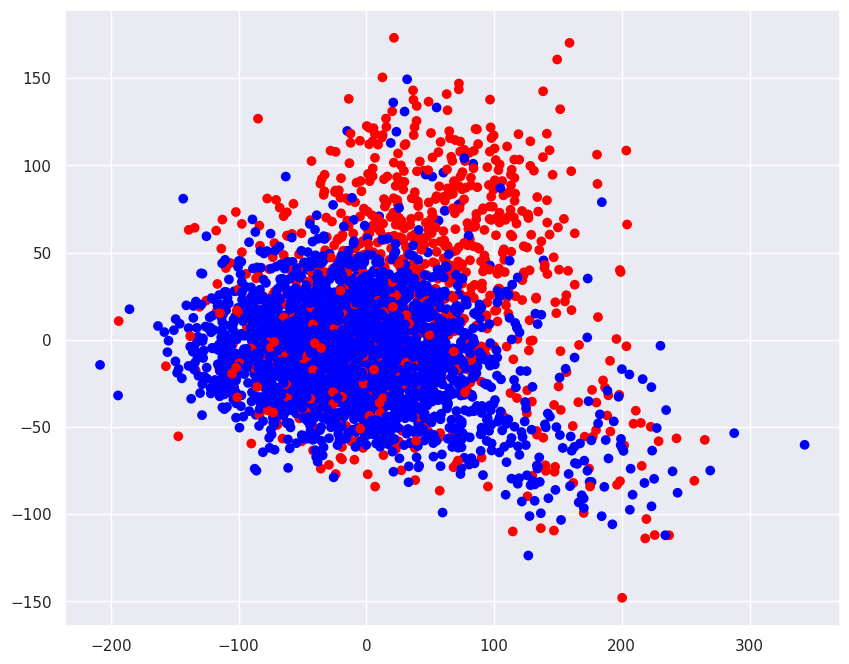

In [ ]:
# Отрисуем точки на плоскости при помощи функции scatter и зададим им цвет согласно их классу передав в аргумент c=['red' if i == 0 else 'blue' for i in df_plot["status"]]

plt.figure(figsize=(10,8))

plt.scatter(df_2d[:,0], df_2d[:,1], c = ['red' if i == 0 else 'blue' for i in df_plot["status"]])

plt.show()

Какие выводы можно сделать, глядя на полученную визуализацию? Каков будет итог нашей работы?